In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from lightning import pytorch as pl
from sklearn.model_selection import train_test_split
import torch
torch.set_float32_matmul_precision('medium')
from chemprop import data, featurizers, models, nn
pl.seed_everything(1)
from utils import *
# from data_utils import data_prep, prep_data, load_data, split_data, preprocess_data, create_data_loaders, create_mpnn_model
%load_ext autoreload
%autoreload 2


Seed set to 1
Seed set to 1


In [3]:
input_path = r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\data\nist\nist_train.parquet"
num_workers = 0 # number of workers for dataloader. 0 means using main process for data loading
smiles_column = "smiles" # name of the column containing SMILES strings
target_columns = np.arange(400,4002,2).astype(str) # list of names of the columns containing targets
df_input = pd.read_parquet(input_path)

nist_test_path = r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\data\nist\nist_test.parquet"
nist_test_df = pd.read_parquet(nist_test_path)
test_datapoints = get_mol_datapoints(nist_test_df, smiles_column, target_columns)
test_dset = data.MoleculeDataset(test_datapoints, featurizers.SimpleMoleculeMolGraphFeaturizer())
test_loader = data.MolGraphDataLoader(test_dset, num_workers=num_workers)

def create_rndm_loader(test_data):
    featurizer = featurizers.SimpleMoleculeMolGraphFeaturizer()


    test_dset = data.MoleculeDataset(test_data, featurizer)

    return data.MolGraphDataLoader(test_dset, num_workers=0)

# rndm_test_loader = create_rndm_loader(test_1[:700])

In [4]:
datapoints = get_mol_datapoints(df_input, smiles_column, target_columns)

train_idx, val_idx, test_idx = data.splitting.split_data(
    datapoints,
    num_folds=8,
    split='cv',
)

train_1 = [datapoints[i] for i in train_idx[0]]
val_1 = [datapoints[i] for i in val_idx[0]]
test_1 = [datapoints[i] for i in test_idx[0]]

train_2 = [datapoints[i] for i in train_idx[1]]
val_2 = [datapoints[i] for i in val_idx[1]]
test_2 = [datapoints[i] for i in test_idx[1]]

train_3 = [datapoints[i] for i in train_idx[2]]
val_3 = [datapoints[i] for i in val_idx[2]]
test_3 = [datapoints[i] for i in test_idx[2]]

train_4 = [datapoints[i] for i in train_idx[3]]
val_4 = [datapoints[i] for i in val_idx[3]]
test_4 = [datapoints[i] for i in test_idx[3]]

train_5 = [datapoints[i] for i in train_idx[4]]
val_5 = [datapoints[i] for i in val_idx[4]]
test_5 = [datapoints[i] for i in test_idx[4]]

train_6 = [datapoints[i] for i in train_idx[5]]
val_6 = [datapoints[i] for i in val_idx[5]]
test_6= [datapoints[i] for i in test_idx[5]]

train_7 = [datapoints[i] for i in train_idx[6]]
val_7 = [datapoints[i] for i in val_idx[6]]
test_7 = [datapoints[i] for i in test_idx[6]]

train_8 = [datapoints[i] for i in train_idx[7]]
val_8 = [datapoints[i] for i in val_idx[7]]
test_8 = [datapoints[i] for i in test_idx[7]]

def create_data_loaders(train_data, val_data, test_data, num_workers=0):
    featurizer = featurizers.SimpleMoleculeMolGraphFeaturizer()

    train_dset = data.MoleculeDataset(train_data, featurizer)
    val_dset = data.MoleculeDataset(val_data, featurizer)
    test_dset = data.MoleculeDataset(test_data, featurizer)

    train_loader = data.MolGraphDataLoader(train_dset, num_workers=num_workers)
    val_loader = data.MolGraphDataLoader(val_dset, num_workers=num_workers, shuffle=False)
    test_loader = data.MolGraphDataLoader(test_dset, num_workers=num_workers, shuffle=False)

    return train_loader, val_loader, test_loader

train_loader_1, val_loader_1, test_loader_1 = create_data_loaders(train_1, val_1, test_1, num_workers)
train_loader_2, val_loader_2, test_loader_2 = create_data_loaders(train_2, val_2, test_2, num_workers)
train_loader_3, val_loader_3, test_loader_3 = create_data_loaders(train_3, val_3, test_3, num_workers)
train_loader_4, val_loader_4, test_loader_4 = create_data_loaders(train_4, val_4, test_4, num_workers)
train_loader_5, val_loader_5, test_loader_5 = create_data_loaders(train_5, val_5, test_5, num_workers)
train_loader_6, val_loader_6, test_loader_6 = create_data_loaders(train_6, val_6, test_6, num_workers)
train_loader_7, val_loader_7, test_loader_7 = create_data_loaders(train_7, val_7, test_7, num_workers)
train_loader_8, val_loader_8, test_loader_8 = create_data_loaders(train_8, val_8, test_8, num_workers)

In [5]:
pre_trained_model_1 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\xtb_modified_mpnn_1.ckpt")
pre_trained_model_2 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\xtb_modified_mpnn_2.ckpt")
pre_trained_model_3 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\xtb_modified_mpnn_3.ckpt")
pre_trained_model_4 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\xtb_modified_mpnn_4.ckpt")
pre_trained_model_5 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\xtb_modified_mpnn_5.ckpt")
pre_trained_model_6 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\xtb_modified_mpnn_6.ckpt")
pre_trained_model_7 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\xtb_modified_mpnn_7.ckpt")
pre_trained_model_8 = models.MPNN.load_from_checkpoint(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\models\xtb_modified_mpnn_8.ckpt")

pre_trained_models = [pre_trained_model_1, pre_trained_model_2, pre_trained_model_3, pre_trained_model_4, pre_trained_model_5, pre_trained_model_6, pre_trained_model_7, pre_trained_model_8]



In [6]:
trainer_1 = pl.Trainer(
    precision='bf16-mixed',
    logger=True,
    enable_checkpointing=False, # Use `True` if you want to save model checkpoints. The checkpoints will be saved in the `checkpoints` folder.
    enable_progress_bar=True,
    accelerator="auto",
    devices=1,
    max_epochs=2, # number of epochs to train for
    # callbacks=[metric_tracker, early_stop_callback]
)

trainer_1.test(pre_trained_model_1, test_loader)

pt_model_1_preds = trainer_1.predict(pre_trained_model_1, test_loader)

pt_model_1_preds = [pred.float() for pred in pt_model_1_preds]

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\logger_connector\logger_connector.py:75: Starting from v1.9.0, `tensorboardX` has been removed as a dependency of the `lightning.pytorch` package, due to potential conflicts with other packages in the ML ecosystem. For this reason, `logger=True` will use `CSVLogger` as the default logger, unless the `tensorboard` or `tensorboardX` packages are found. Please `pip install lightning[extra]` or one of them to enable TensorBoard support by default
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling of

Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 16.80it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.1510637402534485
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:492: Your `predict_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 160.23it/s]


In [7]:
def train_and_test(model, train_dataloader, test_dataloader, num_epochs, num_cycles):
    trainer = pl.Trainer(
    precision='bf16-mixed',
    logger=True,
    enable_checkpointing=False, # Use `True` if you want to save model checkpoints. The checkpoints will be saved in the `checkpoints` folder.
    enable_progress_bar=True,
    accelerator="auto",
    devices=1,
    max_epochs=num_epochs, # number of epochs to train for
    # callbacks=[metric_tracker, early_stop_callback]
)
    
    all_test_values = []
    all_predictions = []
    
    for cycle in range(num_cycles):
        print(f"Cycle {cycle + 1}")
        
        # Train the model for the specified number of epochs
        trainer.fit(model, train_dataloader)
        
        # Test the model and calculate predictions
        test_values = trainer.test(model, test_dataloader)
        predictions = trainer.predict(model, test_dataloader)
        
        
        all_test_values.append(test_values)
        all_predictions.append(predictions)
        
        # Print the predictions or perform any desired analysis
        print("Predictions:", predictions)
    
    return all_test_values, all_predictions





# Specify the number of epochs per cycle and the number of cycles
num_epochs_per_cycle = 2
num_cycles = 50

# Call the train_and_test function
test_values, predictions = train_and_test(pre_trained_model_1, train_loader_1, test_loader, num_epochs_per_cycle, num_cycles)

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\configuration_validator.py:74: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\chemprop\schedulers.py:92: RuntimeWarning: divide by zero encountered in divide
  gammas = (self.final_lrs / max_lrs) ** (1 / cooldow

Cycle 1
Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.94it/s, v_num=27, train/loss=0.00451]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.93it/s, v_num=27, train/loss=0.00451]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 47.06it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07688187062740326
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.92it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.69it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07694530487060547
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0405,  ..., 0.0212, 0.0210, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0304, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07701396942138672
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0194, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0770430639386177
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.54it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0160, 0.0157, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0159, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.69it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07719321548938751
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.91it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0146, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0405,  ..., 0.0211, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0149, 0.0192]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07703922688961029
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0149, 0.0192]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0304, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 47.47it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07705144584178925
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 202.05it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0074, 0.0039, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0146, 0.0190, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.59it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07719584554433823
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.13it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07716763764619827
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.43it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0410, 0.0427, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0194, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0124, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.32it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07715676724910736
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.58it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.69it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07729119807481766
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.52it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0074, 0.0038, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0898,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0830, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.58it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07644253969192505
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.53it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0074, 0.0038, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0405,  ..., 0.0211, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.58it/s]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse            0.076913021504879
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.73it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtyp

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.96it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07717978209257126
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.92it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.32it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07729537785053253
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0200, 0.0217, 0.0208,  ..., 0.0076, 0.0040, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0410, 0.0427, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0304, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07697580754756927
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.19it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0277]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07724970579147339
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.65it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0200, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0160, 0.0157, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0432,  ..., 0.0304, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0356, 0.0376,  ..., 0.0079, 0.0098, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07735980302095413
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.49it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0410, 0.0427, 0.0405,  ..., 0.0212, 0.0210, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07707889378070831
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0376,  ..., 0.0079, 0.0098, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.

Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 46.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0771542340517044
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.24it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0146, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dty

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07713836431503296
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.13it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0076, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07711033523082733
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.96it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0220, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07695148885250092
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.72it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0767640471458435
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.27it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0160, 0.0157, 0.0160]],
       dty

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07716480642557144
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.89it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.69it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07689420133829117
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.39it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.33it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07715536653995514
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.43it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0146, 0.0190, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0327, 0.0277]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.92it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0220, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.72it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07710201293230057
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.07it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0160, 0.0157, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0410, 0.0425, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.67it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0160, 0.0157, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07698167115449905
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.03it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07714188098907471
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.88it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0220, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.69it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07707606256008148
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.07it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0160, 0.0157, 0.0160]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse            0.077237568795681
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.61it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0210, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0124, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.

Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07710105180740356
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.21it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0040, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0304, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0356, 0.0376,  ..., 0.0079, 0.0098, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07698500901460648
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.19it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0074, 0.0039, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.72it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07739530503749847
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.18it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.69it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07702765613794327
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.42it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0227, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0160, 0.0157, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0410, 0.0425, 0.0405,  ..., 0.0212, 0.0210, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0304, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0771717056632042
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.40it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0220, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0160, 0.0157, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0830, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0277]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.94it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07694856077432632
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.00it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 31.62it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07731610536575317
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.70it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0192]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0830, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0330, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07706629484891891
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.35it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.70it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07715388387441635
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.57it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0211, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0304, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.22it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07719042897224426
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0160, 0.0157, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0408, 0.0425, 0.0403,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0195, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0325, 0.0276]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07706345617771149
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.72it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.55it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07732207328081131
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.84it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0144]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.08it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse            0.07748993486166
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.81it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0219, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0074, 0.0038, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dtyp

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.58it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0771302655339241
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 181.54it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0220, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0074, 0.0038, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0146, 0.0190, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0160, 0.0157, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0410, 0.0425, 0.0405,  ..., 0.0212, 0.0209, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0996, 0.0898, 0.0894,  ..., 0.0194, 0.0148, 0.0190]],
       dtype=torch.bfloat16), tensor([[0.0889, 0.0835, 0.0859,  ..., 0.0160, 0.0123, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.0403, 0.0405, 0.0435,  ..., 0.0305, 0.0327, 0.0277]],
       dtype=torch.bfloat16), tensor([[0.0332, 0.0359, 0.0378,  ..., 0.0079, 0.0098, 0.0091]],
       dtype=torch.bfloat16), tensor([[0.0518, 0.0447, 0.0469,  ..., 0.0084, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07658558338880539
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.44it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0220, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0075, 0.0039, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0645,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 46.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07684220373630524
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.37it/s]
Predictions: [tensor([[0.0708, 0.0635, 0.0688,  ..., 0.0226, 0.0220, 0.0239]],
       dtype=torch.bfloat16), tensor([[0.0199, 0.0216, 0.0206,  ..., 0.0074, 0.0038, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0635, 0.0664, 0.0649,  ..., 0.0147, 0.0190, 0.0168]],
       dtype=torch.bfloat16), tensor([[0.0605, 0.0645, 0.0610,  ..., 0.0128, 0.0179, 0.0143]],
       dtype=torch.bfloat16), tensor([[0.0272, 0.0309, 0.0330,  ..., 0.0161, 0.0157, 0.0161]],
       dt

In [8]:
rmse_values = [item[0]['test/rmse'] for item in test_values]

# Find the index of the lowest RMSE
lowest_rmse_index = np.argmin(rmse_values)

print(lowest_rmse_index)

11


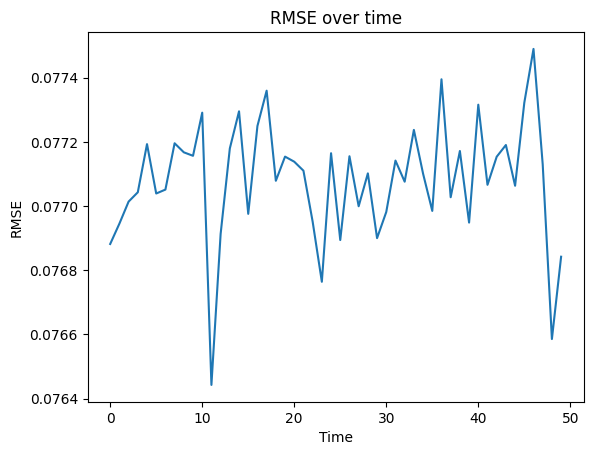

In [9]:
# Extract the RMSE values
rmse_values = [item[0]['test/rmse'] for item in test_values]

# Create a range of numbers for the x-axis (time)
time = range(len(rmse_values))

# Create the plot
plt.plot(time, rmse_values)

# Add title and labels
plt.title('RMSE over time')
plt.xlabel('Time')
plt.ylabel('RMSE')

# Show the plot
plt.show()





In [11]:
def calculate_rmse(predicted_spectra, reference_spectra):
    if len(predicted_spectra) != len(reference_spectra):
        print(len(predicted_spectra), len(reference_spectra))
        raise ValueError("Length of predicted and reference spectra lists should be the same.")

    rmse_values = []

    for i in range(len(predicted_spectra)):
        predicted = np.array(predicted_spectra[i]).squeeze()
        reference = np.array(reference_spectra[i]).squeeze()

        if len(predicted) != len(reference):
            print(len(predicted), len(reference))
            raise ValueError(f"Length of predicted and reference spectra at index {i} should be the same.")

        mse = np.mean((predicted - reference) ** 2)
        rmse = np.sqrt(mse)
        rmse_values.append(rmse)

    return rmse_values

def calculate_sis(predicted_spectra, reference_spectra):
    if len(predicted_spectra) != len(reference_spectra):
        print(len(predicted_spectra), len(reference_spectra))
        raise ValueError("Length of predicted and reference spectra lists should be the same.")

    sis_values = []

    for i in range(len(predicted_spectra)):
        predicted = np.array(predicted_spectra[i]).squeeze()
        reference = np.array(reference_spectra[i]).squeeze()

        if len(predicted) != len(reference):
            print(len(predicted), len(reference))
            raise ValueError(f"Length of predicted and reference spectra at index {i} should be the same.")

        # Set any negative values to zero
        predicted[predicted < 0] = 0
        reference[reference < 0] = 0

        # Add a small constant to avoid taking log of zero
        epsilon = 1e-10
        predicted += epsilon
        reference += epsilon

        # Ensure the spectra are normalized
        predicted = predicted / np.sum(predicted)
        reference = reference / np.sum(reference)

        # Check for negative values
        if np.any(predicted < 0) or np.any(reference < 0):
            raise ValueError("Spectra contain negative values")

        # Check for zero values
        if np.any(predicted == 0) or np.any(reference == 0):
            raise ValueError("Spectra contain zero values")

        # Calculate the SID
        sid = np.sum(predicted * np.log(predicted / reference)) + np.sum(reference * np.log(reference / predicted))

        # Calculate the SIS
        sis = 1 / (1 + sid)
        sis_values.append(sis)

    return sis_values


rmse = calculate_rmse(pt_model_1_preds, [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

sis = calculate_sis(pt_model_1_preds, [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

predictions = [[tensor.float() for tensor in pred_list] for pred_list in predictions]

fine_tuned_rmse = calculate_rmse(predictions[lowest_rmse_index], [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

fine_tuned_sis = calculate_sis(predictions[lowest_rmse_index], [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])



(array([103., 284., 244., 109.,  24.,   2.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   1.]),
 array([0.07380069, 0.10834854, 0.14289638, 0.17744423, 0.21199208,
        0.24653993, 0.28108778, 0.31563563, 0.35018348, 0.38473133,
        0.41927918, 0.45382702, 0.48837487, 0.52292272, 0.55747057,
        0.59201842, 0.62656627, 0.66111412, 0.69566197, 0.73020982,
        0.76475766, 0.79930551, 0.83385336, 0.86840121, 0.90294906,
        0.93749691, 0.97204476]),
 <BarContainer object of 26 artists>)

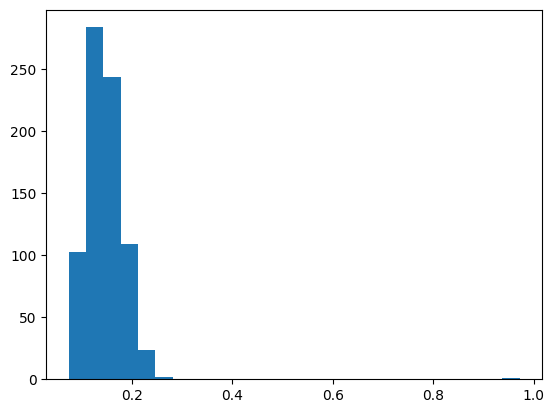

In [12]:
plt.hist(rmse, bins=26)

(array([ 2.,  0.,  0.,  1.,  1.,  1.,  3.,  3., 10.,  9., 11., 26., 26.,
        50., 71., 69., 69., 93., 75., 71., 63., 49., 30., 19.,  8.,  7.]),
 array([0.09268994, 0.11993146, 0.14717299, 0.17441451, 0.20165604,
        0.22889756, 0.25613909, 0.28338061, 0.31062214, 0.33786366,
        0.36510519, 0.39234672, 0.41958824, 0.44682977, 0.47407129,
        0.50131282, 0.52855434, 0.55579587, 0.58303739, 0.61027892,
        0.63752044, 0.66476197, 0.69200349, 0.71924502, 0.74648655,
        0.77372807, 0.8009696 ]),
 <BarContainer object of 26 artists>)

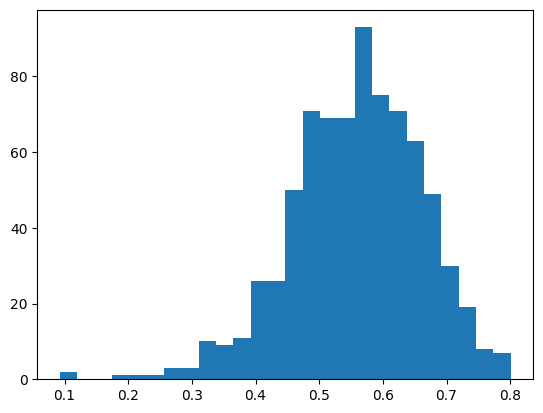

In [13]:
plt.hist(fine_tuned_sis, bins=26)

(array([271., 396.,  83.,  13.,   3.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   1.]),
 array([0.01961657, 0.05665305, 0.09368954, 0.13072602, 0.1677625 ,
        0.20479898, 0.24183546, 0.27887195, 0.31590843, 0.35294491,
        0.38998139, 0.42701787, 0.46405436, 0.50109084, 0.53812732,
        0.5751638 , 0.61220028, 0.64923677, 0.68627325, 0.72330973,
        0.76034621, 0.7973827 , 0.83441918, 0.87145566, 0.90849214,
        0.94552862, 0.98256511]),
 <BarContainer object of 26 artists>)

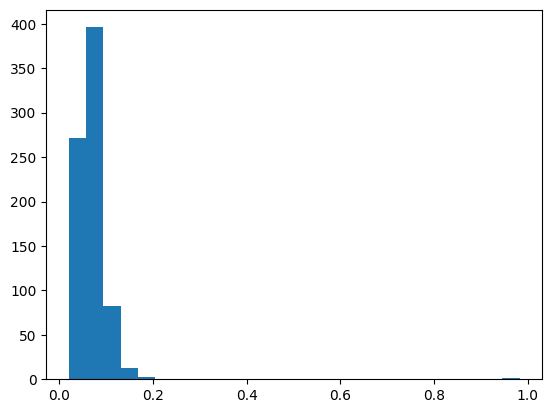

In [14]:
plt.hist(fine_tuned_rmse, bins=26)

(array([ 4.,  4.,  2.,  4.,  3.,  9., 13., 27., 44., 57., 55., 69., 76.,
        63., 67., 69., 58., 57., 33., 21., 15.,  9.,  3.,  2.,  2.,  1.]),
 array([0.12218907, 0.1417329 , 0.16127672, 0.18082055, 0.20036438,
        0.21990821, 0.23945203, 0.25899586, 0.27853969, 0.29808352,
        0.31762734, 0.33717117, 0.356715  , 0.37625882, 0.39580265,
        0.41534648, 0.43489031, 0.45443413, 0.47397796, 0.49352179,
        0.51306561, 0.53260944, 0.55215327, 0.5716971 , 0.59124092,
        0.61078475, 0.63032858]),
 <BarContainer object of 26 artists>)

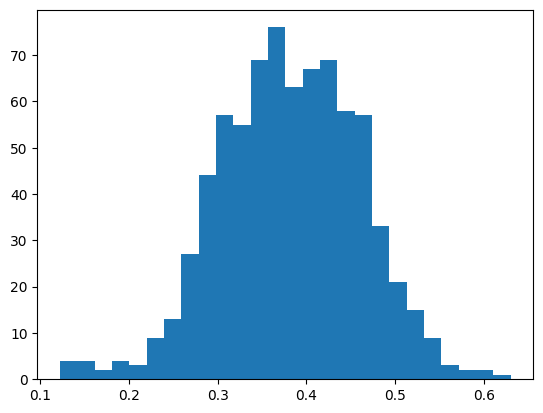

In [15]:
plt.hist(sis, bins=26)

In [16]:
len(sis)

767

In [17]:
xtb_fine_tuned_results = pd.DataFrame({
    "rmse": fine_tuned_rmse,
    "sis": fine_tuned_sis
})

xtb_fine_tuned_results.to_csv(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\results\xtb_fine_tuned_results.csv", index=False)

xtb_fine_tuned_results.describe()

,rmse,sis
count,767.000000,767.000000
mean,0.068513,0.558692
std,0.041697,0.102660
min,0.019617,0.092690
25%,0.049962,0.492277
50%,0.064485,0.563277
75%,0.081614,0.630201
max,0.982565,0.800970


In [18]:
def train_and_test(model, train_dataloader, test_dataloader, num_epochs, num_cycles):
    trainer = pl.Trainer(
        precision='bf16-mixed',
        logger=True,
        enable_checkpointing=False,
        enable_progress_bar=True,
        accelerator="auto",
        devices=1,
        max_epochs=num_epochs,
    )
    
    all_test_values = []
    all_predictions = []
    
    for cycle in range(num_cycles):
        print(f"Cycle {cycle + 1}")
        
        trainer.fit(model, train_dataloader)
        
        test_values = trainer.test(model, test_dataloader)
        predictions = trainer.predict(model, test_dataloader)
        
        all_test_values.append(test_values)
        all_predictions.append(predictions)
        
        print("Predictions:", predictions)
    
    return all_test_values, all_predictions

# Specify the number of epochs per cycle and the number of cycles
num_epochs_per_cycle = 2
num_cycles = 30

# List to store the results for each pre-trained model
all_models_test_values = []
all_models_predictions = []

# Iterate over the eight pre-trained models
for i in range(1, 9):
    print(f"Fine-tuning pre_trained_model_{i}")
    
    # Get the pre-trained model and corresponding train dataloader
    model = globals()[f"pre_trained_model_{i}"]
    train_dataloader = globals()[f"train_loader_{i}"]
    
    # Call the train_and_test function for the current model
    test_values, predictions = train_and_test(model, train_dataloader, test_loader, num_epochs_per_cycle, num_cycles)
    
    # Store the results for the current model
    all_models_test_values.append(test_values)
    all_models_predictions.append(predictions)

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\configuration_validator.py:74: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\chemprop\schedulers.py:92: RuntimeWarning: divide by zero encountered in divide
  gammas = (self.final_lrs / max_lrs) ** (1 / cooldow

Fine-tuning pre_trained_model_1
Cycle 1
Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 26.35it/s, v_num=28, train/loss=0.00452]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 26.34it/s, v_num=28, train/loss=0.00452]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.40it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07549500465393066
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:492: Your `predict_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\rhys-\miniconda3\envs\cp3\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.97it/s]
Predictions: [tensor([[-4.9591e-04,  8.3447e-05,  2.2984e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0791,  ..., 0.0022, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.00

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 26.94it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07563569396734238
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 155.07it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-5.0354e-04,  5.0068e-05,  1.7357e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0747, 0.0708, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0080,  0.0092,  0.0109,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07543035596609116
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 157.97it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0850,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0747, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.37it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07564054429531097
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 163.56it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-5.0354e-04,  6.2943e-05,  2.2030e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0080,  0.0092,  0.0109,  ...,  0.0008,  0.0020, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.03it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07540366798639297
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.57it/s]
Predictions: [tensor([[-4.8828e-04,  5.2452e-05,  1.8501e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.91it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07527924329042435
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.77it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0102,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0035, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0080,  0.0092,  0.0109,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0588, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07564118504524231
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 176.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-4.9210e-04,  7.0572e-05,  2.2888e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.51it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07520000636577606
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.76it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0062, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0747, 0.0708, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0183, 0.0204, 0.0184]],
       dtype=torch.bfloat16), tensor([[ 0.0078,  0.0090,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.88it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse            0.075404092669487
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.87it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0001,  0.0003,  ...,  0.0102,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0062, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0078,  0.0090,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.31it/s]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07551168650388718
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0214, 0.0225, 0.0192,  ..., 0.0074, 0.0062, 0.0061]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0747, 0.0708, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07549860328435898
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.51it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-5.0354e-04,  6.2943e-05,  2.3651e-04,  ...,  1.0132e-02,
          9.7656e-03,  1.3367e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0225, 0.0192,  ..., 0.0074, 0.0062, 0.0061]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0035, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07535669952630997
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.25it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0001,  0.0003,  ...,  0.0101,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0183, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0588, 0.0562, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07547347247600555
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.44it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0001,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0062, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0035, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0080,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07533803582191467
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.33it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0513,  ..., 0.0114, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0107,  ...,  0.0008,  0.0020, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.40it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07510125637054443
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 176.20it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-5.1880e-04,  4.3392e-05,  1.7262e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0747, 0.0708, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.51it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07550927251577377
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.57it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-4.7302e-04,  9.8705e-05,  2.4605e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0850,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0033, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0078,  0.0090,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.04it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07554478943347931
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.11it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0001,  0.0003,  ...,  0.0101,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.40it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0752825140953064
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.43it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0513,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0791,  ..., 0.0022, 0.0033, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.83it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07547170668840408
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.48it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-5.5313e-04,  7.7486e-06,  1.5831e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0513,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0035, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0107,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.11it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07560235261917114
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.50it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-5.3787e-04,  4.1485e-05,  2.2411e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0225, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07531596720218658
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 163.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-5.1498e-04,  7.4863e-05,  2.2888e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0062, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0513,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.38it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07570473849773407
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.37it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0001,  0.0003,  ...,  0.0102,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0007,  0.0019, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0588, 0.0562, 0.0613,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07547517865896225
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 162.79it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0001,  0.0003,  ...,  0.0102,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0033, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0183, 0.0204, 0.0184]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.61it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07559358328580856
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.78it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0101,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0747, 0.0708, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.83it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07577364891767502
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 160.49it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-4.9973e-04,  9.6321e-05,  2.6512e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3367e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0107,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.48it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07546084374189377
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.36it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-5.0735e-04,  6.1035e-05,  2.0981e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0192,  ..., 0.0074, 0.0062, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0080,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.60it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07509854435920715
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.28it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0001,  0.0003,  ...,  0.0101,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0035, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0183, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.33it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07550184428691864
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-4.9591e-04,  5.2691e-05,  1.8883e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0078,  0.0091,  0.0107,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.02it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07529175281524658
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.41it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0005,  0.0001,  0.0003,  ...,  0.0101,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0513,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0791,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.70it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07539006322622299
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.97it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-5.1880e-04,  8.0585e-05,  2.1458e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0033, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.91it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07550644129514694
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 167.21it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0033, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07531681656837463
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.88it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0101,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0033, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07520131766796112
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.55it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-4.9973e-04,  8.5354e-05,  2.5749e-04,  ...,  1.0193e-02,
          9.7656e-03,  1.3367e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0033, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0183, 0.0205, 0.0184]],
       dtype=torch.bfloat16), tensor([[ 0.0078,  0.0090,  0.0107,  ...,  0.0008,  0.0020, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.74it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07555636763572693
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.48it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0101,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0035, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.10it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07537306845188141
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.77it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-4.9973e-04,  7.9155e-05,  2.0885e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0033, 0.0025]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0078,  0.0091,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07544498145580292
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.73it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-5.1880e-04,  2.5272e-05,  1.6117e-04,  ...,  1.0132e-02,
          9.6436e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0513,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0033, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.47it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07547134906053543
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.27it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0005,  0.0001,  0.0003,  ...,  0.0101,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.83it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07546813040971756
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 168.83it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0102,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07553714513778687
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.24it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0005,  0.0001,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0147]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0007,  0.0019, -0.0016]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 30.42it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07556852698326111
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.41it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-4.7493e-04,  9.4891e-05,  2.3651e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0192,  ..., 0.0074, 0.0062, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0791,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0078,  0.0090,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.41it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse            0.075434111058712
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.28it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0005,  0.0001,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0033, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.12it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07532967627048492
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-4.9591e-04,  7.1049e-05,  2.1553e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.79it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07541332393884659
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0001,  0.0003,  ...,  0.0102,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0107,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.45it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07552965730428696
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.75it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0537,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0791,  ..., 0.0021, 0.0033, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.93it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07585746049880981
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.90it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0005,  0.0002,  0.0003,  ...,  0.0102,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0513,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0850,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.65it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07528341561555862
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 168.40it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0001,  0.0003,  ...,  0.0101,  0.0097,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0128, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0850,  ..., 0.0035, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0092,  0.0108,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07526720315217972
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.83it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-4.9210e-04,  7.9632e-05,  2.1744e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0087, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0022, 0.0033, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0078,  0.0091,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.12it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07546016573905945
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-4.8828e-04,  9.7752e-05,  2.3174e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0225, 0.0190,  ..., 0.0074, 0.0062, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0747, 0.0713, 0.0786,  ..., 0.0022, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0080,  0.0092,  0.0109,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.04it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07583547383546829
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.17it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[-0.0004,  0.0002,  0.0003,  ...,  0.0102,  0.0098,  0.0134]],
       dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0513,  ..., 0.0114, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0088]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0080,  0.0092,  0.0109,  ...,  0.0007,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.0586, 0.0559, 0.0610,  ...


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07557923346757889
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 166.67it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True


[tensor([[-4.8447e-04,  7.7724e-05,  2.2888e-04,  ...,  1.0132e-02,
          9.7046e-03,  1.3306e-02]], dtype=torch.bfloat16), tensor([[0.0212, 0.0223, 0.0190,  ..., 0.0074, 0.0061, 0.0060]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0544, 0.0535,  ..., 0.0114, 0.0114, 0.0142]],
       dtype=torch.bfloat16), tensor([[0.0508, 0.0537, 0.0515,  ..., 0.0115, 0.0127, 0.0146]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0071, 0.0076,  ..., 0.0100, 0.0072, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.0996, 0.1006,  ..., 0.0140, 0.0088, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0874, 0.0791, 0.0854,  ..., 0.0034, 0.0056, 0.0065]],
       dtype=torch.bfloat16), tensor([[0.0752, 0.0713, 0.0786,  ..., 0.0021, 0.0032, 0.0024]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0576, 0.0588,  ..., 0.0182, 0.0204, 0.0183]],
       dtype=torch.bfloat16), tensor([[ 0.0079,  0.0091,  0.0107,  ...,  0.0008,  0.0019, -0.0015]],
       dtype=torch.bfloat16), tensor([[0.

TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Cycle 1
Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.13it/s, v_num=29, train/loss=0.00521]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.12it/s, v_num=29, train/loss=0.00521]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.10it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07651662826538086
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 166.52it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0596,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0491, 0.0522, 0.0532,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0369, 0.0376,  ..., 0.01

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07675430178642273
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.43it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0532,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0132, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 29.57it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07678177952766418
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.82it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0231, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0132, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.28it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07692044228315353
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.44it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0583, 0.0566, 0.0601,  ..., 0.0178, 0.0181, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.95it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07689793407917023
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.36it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0068, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0143, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0033, 0.0086]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0210]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0134, 0.0146,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.96it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0766795352101326
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 168.52it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0033, 0.0086]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07689567655324936
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 165.62it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0231, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0583, 0.0566, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0153, 0.0132, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07666582614183426
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 168.50it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0033, 0.0086]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0132, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.03it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0769074559211731
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.05it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0038, -0.0068, -0.0042,  ...,  0.0046,  0.0052,  0.0060]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0033, 0.0086]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0532,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07646651566028595
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.01it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0231, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0143, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0177, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.36it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07664153724908829
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.70it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0243, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0532,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07684478908777237
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.70it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0068, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.82it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07650188356637955
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 164.91it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0272, 0.0297,  ..., 0.0116, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0068, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.79it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07670890539884567
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.09it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0583, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.95it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07664168626070023
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.51it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0143, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.55it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07652614265680313
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.77it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0038, -0.0068, -0.0042,  ...,  0.0046,  0.0052,  0.0060]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0532,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0768684670329094
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.24it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0231, 0.0271, 0.0295,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0038, -0.0068, -0.0042,  ...,  0.0046,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0033, 0.0086]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.21it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0766768753528595
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.24it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0033, 0.0086]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0153, 0.0132, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.46it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07663647830486298
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.44it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0033, 0.0086]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0583, 0.0566, 0.0601,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0153, 0.0132, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.74it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07693894952535629
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.50it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0038, -0.0068, -0.0042,  ...,  0.0046,  0.0052,  0.0060]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0143, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0583, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07682942599058151
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 173.06it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0143, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.04it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07663288712501526
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0143, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0033, 0.0086]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0532,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.61it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07681042701005936
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.82it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.86it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07660528272390366
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.47it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07706280052661896
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.98it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0068, -0.0042,  ...,  0.0046,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0153, 0.0132, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.01it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0768856480717659
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 167.03it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0231, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07704051584005356
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.86it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0583, 0.0566, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0491, 0.0522, 0.0532,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.21it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07647950947284698
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 163.91it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07666947692632675
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.84it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0491, 0.0522, 0.0532,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.04it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07673437148332596
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 170.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0130]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0068, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0153, 0.0132, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 32.72it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0764991044998169
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.63it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.68it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07621370255947113
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.40it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0231, 0.0271, 0.0295,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0583, 0.0566, 0.0601,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0491, 0.0522, 0.0532,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 32.72it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07701760530471802
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 169.15it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0068, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0153, 0.0132, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.92it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07674496620893478
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.73it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0033, 0.0086]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0532,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07650528103113174
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.84it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0231, 0.0271, 0.0295,  ..., 0.0115, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0038, -0.0068, -0.0042,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0143, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0181, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.10it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0766756683588028
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.43it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0132, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.22it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0769464522600174
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.77it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0767286866903305
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.26it/s]
Predictions: [tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0068, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
    

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.08it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07672258466482162
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0583, 0.0566, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07666632533073425
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.47it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0122, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0583, 0.0566, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0153, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0374, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.01it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07654090225696564
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0491, 0.0522, 0.0532,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0768706202507019
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.56it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0068, -0.0042,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0532,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0153, 0.0132, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07656276226043701
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0231, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0051,  0.0058]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0500, 0.0527,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0132, 0.0145,  ..., 0.0223, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.30it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07671155780553818
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.67it/s]
Predictions: [tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07678856700658798
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0256, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0491, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.03it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07694849371910095
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.15it/s]
Predictions: [tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0172,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0069, 0.0036,  ..., 0.0079, 0.0034, 0.0087]],
   

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07639048248529434
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.42it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0143, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.21it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07676810026168823
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 171.82it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0068, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0143, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0166]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0532,  ..., 0.0327, 0.0278, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0134, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07668371498584747
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.46it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0295,  ..., 0.0116, 0.0138, 0.0129]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0132, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0581, 0.0564, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0133, 0.0145,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.84it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07696115225553513
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.33it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0232, 0.0271, 0.0297,  ..., 0.0117, 0.0139, 0.0130]],
       dtype=torch.bfloat16), tensor([[-0.0039, -0.0069, -0.0043,  ...,  0.0045,  0.0052,  0.0059]],
       dtype=torch.bfloat16), tensor([[0.0145, 0.0182, 0.0171,  ..., 0.0132, 0.0126, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0144, 0.0175, 0.0168,  ..., 0.0123, 0.0118, 0.0118]],
       dtype=torch.bfloat16), tensor([[0.0084, 0.0070, 0.0036,  ..., 0.0078, 0.0034, 0.0087]],
       dtype=torch.bfloat16), tensor([[0.0449, 0.0503, 0.0530,  ..., 0.0258, 0.0242, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0513, 0.0503, 0.0510,  ..., 0.0133, 0.0139, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0583, 0.0566, 0.0598,  ..., 0.0178, 0.0179, 0.0167]],
       dtype=torch.bfloat16), tensor([[0.0488, 0.0522, 0.0530,  ..., 0.0327, 0.0277, 0.0310]],
       dtype=torch.bfloat16), tensor([[0.0154, 0.0134, 0.0146,  ..., 0.0222, 0.0214, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0371, 0.0376,  ..., 0.01


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 28.27it/s, v_num=30, train/loss=0.00436]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 28.26it/s, v_num=30, train/loss=0.00436]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.40it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07818600535392761
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.13it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0481, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0133, 0.0132, 0.0151,  ..., 0.0107, 0.0082, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0248, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.26it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0464, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.87it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07777021080255508
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 178.04it/s]
Predictions: [tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0148, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07786476612091064
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.52it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0095, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0114, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0464, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.84it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07802239060401917
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.53it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0393, 0.0410,  ..., 0.0148, 0.0142, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0327,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0097, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07803855836391449
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.77it/s]
Predictions: [tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.33it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07803508639335632
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 174.64it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0151]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0248, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.21it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0781458243727684
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.12it/s]
Predictions: [tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0113,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0479,  ..., 0.0148, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dty

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07788047939538956
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.58it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0121, 0.0063, 0.0066,  ..., 0.0060, 0.0063, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0098]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0481, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0245, 0.0344, 0.0327,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07829156517982483
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.75it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0113,  ..., 0.0074, 0.0090, 0.0098]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.33it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0781073048710823
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.36it/s]
Predictions: [tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0113,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dty

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07818328589200974
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.34it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07818739861249924
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.47it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0061, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.50it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0780024379491806
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.32it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0408,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.01it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07795102149248123
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.42it/s]
Predictions: [tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0148, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07802068442106247
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.66it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0121, 0.0063, 0.0066,  ..., 0.0060, 0.0063, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0481, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.33it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07806986570358276
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0464, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0262, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0245, 0.0344, 0.0327,  ..., 0.0115, 0.0126, 0.0183]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.88it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07778775691986084
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.23it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0121, 0.0062, 0.0065,  ..., 0.0060, 0.0063, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0148, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0148, 0.0142, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.69it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07792522758245468
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.67it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0112,  ..., 0.0074, 0.0090, 0.0098]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0481, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0148, 0.0142, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.01it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07803821563720703
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.46it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0121, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0393, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0212, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.83it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0776061937212944
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.30it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0481, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0256]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0327,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.80it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0782000720500946
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.68it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0113,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0464, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0212, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0779915452003479
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.00it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0479,  ..., 0.0148, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0149, 0.0143, 0.0151]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0249, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0248, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.90it/s]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0776946097612381
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.44it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0464, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0212, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.34it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07806748151779175
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.64it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0120, 0.0061, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0393, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0442, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0098, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0783456489443779
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 172.20it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0393, 0.0410,  ..., 0.0149, 0.0142, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0327,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.60it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07774890959262848
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.44it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0221, 0.0212, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0248, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07807369530200958
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.72it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0113,  ..., 0.0074, 0.0090, 0.0098]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.02it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0780869722366333
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.96it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0113,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0464, 0.0396, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0408,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.33it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07826299220323563
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.27it/s]
Predictions: [tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0481, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 30.36it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07818503677845001
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.79it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0114, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0248, 0.0344, 0.0330,  ..., 0.0114, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.60it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07802967727184296
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.80it/s]
Predictions: [tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.93it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07825052738189697
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.30it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0112,  ..., 0.0074, 0.0090, 0.0098]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0479,  ..., 0.0148, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0393, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0212, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07789073884487152
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.30it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0151]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.55it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07823304086923599
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.19it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0113,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0151]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.61it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07799038290977478
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.93it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0121, 0.0063, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0393, 0.0410,  ..., 0.0148, 0.0142, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0258]],
       dtype=torch.bfloat16), tensor([[0.0245, 0.0344, 0.0327,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.90it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07792150974273682
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.39it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0114,  ..., 0.0074, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0327,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07775671780109406
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0113,  ..., 0.0074, 0.0090, 0.0098]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0481, 0.0481,  ..., 0.0149, 0.0114, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0097, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0779522955417633
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.77it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0121, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0464, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0151]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.89it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07800181955099106
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.76it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0121, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.72it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07798013091087341
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.88it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0063, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0113,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0249, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0248, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07780791819095612
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.85it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0400, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07809888571500778
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.92it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0121, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0417, 0.0405,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.61it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07803980261087418
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.17it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0121, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0113,  ..., 0.0074, 0.0090, 0.0098]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0481, 0.0481,  ..., 0.0149, 0.0114, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0393, 0.0410,  ..., 0.0148, 0.0142, 0.0150]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0212, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.30it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0780051052570343
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0064,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0115, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0151]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.70it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0781240314245224
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.09it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0061, 0.0064,  ..., 0.0059, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0074, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dtype=torch.bfloat16), tensor([[0.0464, 0.0396, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0256]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0330,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.95it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07808423787355423
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.37it/s]
Predictions: [tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0063, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0113,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0132, 0.0132, 0.0150,  ..., 0.0106, 0.0081, 0.0123]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.56it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07828423380851746
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.50it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0112,  ..., 0.0074, 0.0090, 0.0098]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0464, 0.0396, 0.0410,  ..., 0.0150, 0.0144, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0261, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0327,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0097, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07786989212036133
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.06it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0120, 0.0062, 0.0065,  ..., 0.0060, 0.0062, 0.0089]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0094, 0.0114,  ..., 0.0075, 0.0090, 0.0099]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0113, 0.0159]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0127, 0.0161]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0259]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0327,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0780329555273056
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.88it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True


[tensor([[0.0121, 0.0063, 0.0065,  ..., 0.0060, 0.0063, 0.0090]],
       dtype=torch.bfloat16), tensor([[0.0114, 0.0093, 0.0112,  ..., 0.0074, 0.0090, 0.0098]],
       dtype=torch.bfloat16), tensor([[0.0520, 0.0479, 0.0481,  ..., 0.0149, 0.0114, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0554, 0.0508, 0.0520,  ..., 0.0161, 0.0126, 0.0160]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0133, 0.0151,  ..., 0.0106, 0.0081, 0.0124]],
       dtype=torch.bfloat16), tensor([[0.0461, 0.0396, 0.0410,  ..., 0.0150, 0.0143, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.2012, 0.2090, 0.2021,  ..., 0.0260, 0.0264, 0.0255]],
       dtype=torch.bfloat16), tensor([[0.1934, 0.1963, 0.1924,  ..., 0.0250, 0.0251, 0.0228]],
       dtype=torch.bfloat16), tensor([[0.0444, 0.0415, 0.0403,  ..., 0.0220, 0.0211, 0.0258]],
       dtype=torch.bfloat16), tensor([[0.0247, 0.0344, 0.0327,  ..., 0.0115, 0.0126, 0.0184]],
       dtype=torch.bfloat16), tensor([[0.0405, 0.0398, 0.0410,  ..., 0.0098, 0.

TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Cycle 1
Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.30it/s, v_num=31, train/loss=0.00522]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 27.30it/s, v_num=31, train/loss=0.00522]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.63it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07761291414499283
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.56it/s]
Predictions: [tensor([[0.0170, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0527, 0.0544,  ..., 0.0058, 0.0082, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07757200300693512
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.72it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0170, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0058, 0.0082, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07765091955661774
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.61it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0058, 0.0082, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0069, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.84it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07733287662267685
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.76it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0058, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0127, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 31.68it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07757194340229034
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.75it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0106]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0058, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07736128568649292
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.13it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0106]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0127, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0190, 0.0189,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07734046131372452
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.18it/s]
Predictions: [tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.48it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07761571556329727
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.99it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0532, 0.0554,  ..., 0.0093, 0.0127, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.37it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07743790000677109
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.94it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0080]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0096, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1123, 0.1147,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.79it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07750017195940018
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.62it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0153, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0182, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.55it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07736114412546158
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.45it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.51it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07775995880365372
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.44it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0058, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1123, 0.1147,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0190, 0.0189,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.12it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07755318284034729
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.92it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0058, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1123, 0.1147,  ..., 0.0183, 0.0157, 0.0183]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 0.0464,  0.0522,  0.0493,  ...,  0.0001


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.95it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07759202271699905
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.60it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0058, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.1035, 0.1050,  ..., 0.0153, 0.0145, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0532, 0.0554,  ..., 0.0093, 0.0127, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0190, 0.0189,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.51it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07778926938772202
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.01it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0058, 0.0082, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 0.0464,  0.0522,  0.0493,  ...,  0.0001


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 30.02it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07769523561000824
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.19it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.70it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07746116816997528
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.37it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0058, 0.0082, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0182, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.02it/s]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07754341512918472
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.32it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0151, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0069, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07744462788105011
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 181.28it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0106]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0096, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0127, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0069, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.61it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07699861377477646
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.69it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0056, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1123, 0.1147,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0532, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0775405615568161
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.97it/s]
Predictions: [tensor([[0.0170, 0.0151, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dty

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.51it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07753775268793106
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.56it/s]
Predictions: [tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0773451030254364
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 177.40it/s]
Predictions: [tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dty

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.40it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0779152438044548
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.72it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1123, 0.1147,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07751034200191498
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.76it/s]
Predictions: [tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.92it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07721440494060516
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.37it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1147,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07757707685232162
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.62it/s]
Predictions: [tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07772154361009598
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.64it/s]
Predictions: [tensor([[0.0170, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0771772637963295
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.06it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0056, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0182, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0127, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0771959125995636
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.68it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0170, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0527, 0.0544,  ..., 0.0056, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07767566293478012
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.58it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0106]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1147,  ..., 0.0183, 0.0157, 0.0183]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0532, 0.0554,  ..., 0.0093, 0.0127, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0190, 0.0189,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07756692171096802
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.94it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0127, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.23it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07770463824272156
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.01it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0183]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 0.0464,  0.0522,  0.0493,  ...,  0.0001


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07753540575504303
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.25it/s]
Predictions: [tensor([[0.0171, 0.0153, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.70it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07766825705766678
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.47it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0106]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0532, 0.0554,  ..., 0.0093, 0.0127, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.20it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0773535743355751
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.07it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0234, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.03it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0777096077799797
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.74it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0058, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 30.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07774699479341507
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 183.80it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0106]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0096, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0175, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.02it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07733500748872757
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.56it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0151, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0200,  ..., 0.0076, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0182, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.80it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07740792632102966
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.26it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0200,  ..., 0.0076, 0.0086, 0.0106]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1123, 0.1147,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 31.25it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0776955634355545
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.66it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0182, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.47it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07761432975530624
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.00it/s]
Predictions: [tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07745838165283203
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.34it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0171, 0.0153, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0058, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.1035, 0.1045,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0182, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.40it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0774645209312439
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0058, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0532, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0190, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9561e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07758650183677673
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.36it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0058, 0.0082, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.41it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0772363469004631
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.70it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0056, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0182, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 0.0464,  0.0522,  0.0493,  ...,  0.0001


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.41it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07732106745243073
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.76it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0171, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0237, 0.0200,  ..., 0.0075, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0557, 0.0525, 0.0544,  ..., 0.0058, 0.0081, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.1035, 0.1045,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0182, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0532, 0.0554,  ..., 0.0093, 0.0127, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 32.32it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07739636301994324
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.39it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0170, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0086, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0102, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07757149636745453
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.85it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0170, 0.0152, 0.0151,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0076, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0077]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0525, 0.0544,  ..., 0.0057, 0.0081, 0.0069]],
       dtype=torch.bfloat16), tensor([[0.1021, 0.1035, 0.1045,  ..., 0.0152, 0.0145, 0.0152]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0157, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0530, 0.0554,  ..., 0.0093, 0.0126, 0.0114]],
       dtype=torch.bfloat16), tensor([[0.0210, 0.0192, 0.0190,  ..., 0.0069, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 30.42it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0773395448923111
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.69it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True


[tensor([[0.0170, 0.0152, 0.0152,  ..., 0.0044, 0.0036, 0.0047]],
       dtype=torch.bfloat16), tensor([[0.0236, 0.0238, 0.0200,  ..., 0.0075, 0.0087, 0.0105]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0383, 0.0417,  ..., 0.0103, 0.0089, 0.0081]],
       dtype=torch.bfloat16), tensor([[0.0425, 0.0400, 0.0437,  ..., 0.0097, 0.0085, 0.0078]],
       dtype=torch.bfloat16), tensor([[0.0134, 0.0173, 0.0173,  ..., 0.0146, 0.0104, 0.0137]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0527, 0.0544,  ..., 0.0058, 0.0082, 0.0070]],
       dtype=torch.bfloat16), tensor([[0.1025, 0.1035, 0.1050,  ..., 0.0153, 0.0146, 0.0153]],
       dtype=torch.bfloat16), tensor([[0.1123, 0.1128, 0.1152,  ..., 0.0183, 0.0156, 0.0182]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0532, 0.0554,  ..., 0.0093, 0.0126, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0211, 0.0192, 0.0190,  ..., 0.0068, 0.0041, 0.0044]],
       dtype=torch.bfloat16), tensor([[ 4.6387e-02,  5.2246e-02,  4.9316e-02,  

TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Cycle 1
Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 28.67it/s, v_num=32, train/loss=0.0054] 

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 28.66it/s, v_num=32, train/loss=0.0054]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.12it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07775446772575378
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.80it/s]
Predictions: [tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0109,  ..., 0.0129, 0.0173, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0437, 0.0408, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.90it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07778067886829376
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 180.13it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0437, 0.0408, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0123, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.72it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07785384356975555
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.01it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0104, 0.0101]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1641, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0120, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.80it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07799582183361053
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 182.27it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0107,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0117, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0398, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.09it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07819373160600662
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.02it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0066, 0.0065, 0.0109,  ..., 0.0129, 0.0173, 0.0156]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0249, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.19it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07785700261592865
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 179.48it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0065, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0339, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0120, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0378,  ..., 0.0124, 0.

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 31.62it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07807762175798416
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.58it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.11it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07778594642877579
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0260, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1641, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0398, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.88it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0777469053864479
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.59it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0120, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0780501440167427
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.94it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0260, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.96it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07791178673505783
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.03it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0120, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1641, 0.1641, 0.1611,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.53it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07751669734716415
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 202.86it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0120, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0123, 0.

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.67it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07788561284542084
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.42it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0109,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0117, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0260, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0378, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.28it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07791908085346222
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0065, 0.0108,  ..., 0.0128, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0120, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0376,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07776513695716858
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.57it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.78it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07811083644628525
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.52it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0066, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0339, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07783162593841553
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 202.96it/s]
Predictions: [tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 45.07it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07823441922664642
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.91it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.72it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07801949232816696
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.34it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07796785235404968
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.98it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0106,  ..., 0.0129, 0.0172, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07802269607782364
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.04it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0232, 0.0239, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07778403908014297
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.20it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0339, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0117, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0236, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0260, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0398, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07795169204473495
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 178.29it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0447, 0.0442, 0.0459,  ..., 0.0203, 0.0242, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07785183936357498
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.73it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.11it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07815657556056976
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 181.54it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0398, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.91it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07818297296762466
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.52it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0376,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.82it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07803133130073547
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.64it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0120, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07787789404392242
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.75it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0107,  ..., 0.0128, 0.0172, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1504, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.90it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0778694897890091
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.99it/s]
Predictions: [tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dty

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.84it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07775614410638809
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0108,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0239, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0120, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.29it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07787778973579407
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.78it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0339, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1504, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1641, 0.1641, 0.1611,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.28it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07813659310340881
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 201.63it/s]
Predictions: [tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0064, 0.0107,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0339, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0117, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.13it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07790139317512512
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.67it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0398, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07803228497505188
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.55it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0106,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07794815301895142
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.43it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0398, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07798215746879578
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.22it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07833919674158096
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.96it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0172, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0339, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0120, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.01it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07796085625886917
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.53it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0376,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.01it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07779034972190857
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.61it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0117, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0120, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07784256339073181
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.91it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0064, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0129, 0.0120, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0120, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07780636101961136
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.58it/s]
Predictions: [tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dt

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07790395617485046
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 185.76it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0064, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0120, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1641, 0.1641, 0.1611,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.88it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07782283425331116
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.24it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0236, 0.0248, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0232, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0120, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.46it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07799635082483292
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.69it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.84it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07804322242736816
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.48it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0064, 0.0063, 0.0107,  ..., 0.0129, 0.0172, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0249, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0376, 0.0376,  ..., 0.0124, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.28it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07776372879743576
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 187.12it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0064, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 175.25it/s]
Predictions: [tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0232, 0.0240, 0.0248]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07792416960000992
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.05it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0108,  ..., 0.0129, 0.0172, 0.0154]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0129, 0.0120, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0312, 0.0374,  ..., 0.0118, 0.0104, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0408, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1650, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.04it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07771722227334976
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.97it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0063, 0.0063, 0.0107,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0131, 0.0121, 0.0116]],
       dtype=torch.bfloat16), tensor([[0.0354, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0237, 0.0249, 0.0247]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0226, 0.0261, 0.0265]],
       dtype=torch.bfloat16), tensor([[0.1641, 0.1641, 0.1621,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0295,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.28it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07749894261360168
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.86it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[0.0444, 0.0442, 0.0459,  ..., 0.0203, 0.0240, 0.0214]],
       dtype=torch.bfloat16), tensor([[0.0065, 0.0065, 0.0109,  ..., 0.0129, 0.0173, 0.0155]],
       dtype=torch.bfloat16), tensor([[0.0342, 0.0322, 0.0369,  ..., 0.0130, 0.0121, 0.0115]],
       dtype=torch.bfloat16), tensor([[0.0352, 0.0315, 0.0374,  ..., 0.0118, 0.0103, 0.0100]],
       dtype=torch.bfloat16), tensor([[0.0220, 0.0190, 0.0194,  ..., 0.0055, 0.0058, 0.0056]],
       dtype=torch.bfloat16), tensor([[0.0435, 0.0405, 0.0474,  ..., 0.0236, 0.0248, 0.0245]],
       dtype=torch.bfloat16), tensor([[0.1494, 0.1494, 0.1494,  ..., 0.0227, 0.0261, 0.0266]],
       dtype=torch.bfloat16), tensor([[0.1641, 0.1641, 0.1611,  ..., 0.0233, 0.0240, 0.0249]],
       dtype=torch.bfloat16), tensor([[0.0427, 0.0400, 0.0483,  ..., 0.0332, 0.0334, 0.0339]],
       dtype=torch.bfloat16), tensor([[0.0250, 0.0265, 0.0294,  ..., 0.0123, 0.0119, 0.0157]],
       dtype=torch.bfloat16), tensor([[0.0376, 0.0378, 0.0378,  ..., 0.0124, 0.


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 28.38it/s, v_num=33, train/loss=0.00368]

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 28.38it/s, v_num=33, train/loss=0.00368]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.65it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07956511527299881
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.99it/s]
Predictions: [tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -1.3232e-05,
          3.6163e-03,  2.9755e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07933256030082703
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 184.42it/s]
Predictions: [tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0064,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0003,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -4.8399e-05,
          3.5858e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 35.79it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07923029363155365
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.97it/s]
Predictions: [tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0126,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -4.1962e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.61it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07940304279327393
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 186.62it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0003]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.1710e-05,
          3.6011e-03,  2.9602e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0112, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0393, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.33it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07928016781806946
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.00it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.5524e-05,
          3.6011e-03,  2.9602e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0144, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0178]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0393, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.00it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07922658324241638
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 181.58it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0067, -0.0065,  0.0005]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -1.8120e-05,
          3.6316e-03,  2.9755e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0510, 0.0510,  ..., 0.0063, 0.0112, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0942,  ..., 0.0171, 0.0145, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0145, 0.0206, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0393, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.03it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07945512980222702
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.88it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.5763e-05,
          3.6163e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0144, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0299, 0.0300, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.61it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07919339090585709
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 178.29it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -5.9605e-05,
          3.5706e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0062, 0.0110, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0150, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.22it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0794653445482254
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.61it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[4.4189e-02, 4.5410e-02, 4.2969e-02,  ..., 6.4373e-06, 3.6163e-03,
         2.9602e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0510, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0150, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0145, 0.0206, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16), tenso


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07971559464931488
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.71it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0026, -0.0005,  0.0003]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -4.0054e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0110, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0168, 0.0144, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0393, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07927344739437103
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.49it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0003]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -2.3007e-05,
          3.5858e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0510, 0.0510,  ..., 0.0062, 0.0110, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0150, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.28it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07929904013872147
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.43it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0067, -0.0065,  0.0005]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.7670e-05,
          3.6163e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0510, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0898, 0.0933,  ..., 0.0168, 0.0143, 0.0210]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.02it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07952432334423065
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.61it/s]
Predictions: [tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.0756e-05,
          3.5858e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07972694933414459
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 201.84it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.5048e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0062, 0.0110, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07947735488414764
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 202.16it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.8624e-05,
          3.5858e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0510, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0166, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.53it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0793859213590622
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.50it/s]
Predictions: [tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -2.8253e-05,
          3.6011e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 44.69it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07937096804380417
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 202.88it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0126,  0.0160,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.2663e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0062, 0.0110, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0150, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.87it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07960352301597595
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 197.73it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0003,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.0279e-05,
          3.6163e-03,  2.9755e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0112, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.70it/s]
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0795464813709259
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.38it/s]
Predictions: [tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0126,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -6.0320e-05,
          3.5706e-03,  2.9144e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tenso

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.10it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07927244156599045
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.64it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.2663e-05,
          3.6011e-03,  2.9602e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0942,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.20it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07936625927686691
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 178.83it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -4.1723e-05,
          3.5858e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0110, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0908, 0.0942,  ..., 0.0170, 0.0145, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0297, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0178]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0107, 0.0104, 0.0061]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 39.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07928095012903214
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.69it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0064,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0003]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -2.8372e-05,
          3.6011e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0150, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0107, 0.0104, 0.0061]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07973221689462662
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 188.78it/s]
Predictions: [tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0126,  0.0159,  0.0145,  ...,  0.0027, -0.0003,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.6240e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.24it/s]


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07798022776842117
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.69it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -2.7299e-05,
          3.5858e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0168, 0.0144, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.45it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07923723757266998
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 190.32it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0003]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.4273e-07,
          3.6163e-03,  2.9602e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0107, 0.0104, 0.0061]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0794839859008789
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.20it/s]
Predictions: [tensor([[ 0.0289,  0.0261,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0003]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.9339e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.33it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07943308353424072
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 202.00it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -1.2696e-05,
          3.5858e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0150, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0168, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.09it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07949674129486084
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 200.68it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0288,  0.0261,  0.0276,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -2.3603e-05,
          3.6163e-03,  2.9755e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0044, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0757,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 38.09it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07941433787345886
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.26it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0126,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -4.1723e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0178]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.71it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07960304617881775
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.64it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -2.6345e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0110, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0393, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 33.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07942251861095428
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.13it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0003]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.2187e-05,
          3.5858e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.44it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07952075451612473
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 191.10it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0003]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -1.6451e-05,
          3.6163e-03,  2.9602e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0110, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0150, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0107, 0.0104, 0.0061]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.03it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07938876748085022
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 191.87it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0028, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -6.2466e-05,
          3.5706e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0062, 0.0110, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0150, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0942,  ..., 0.0170, 0.0145, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0107, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.88it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07939352840185165
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 196.62it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0126,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[4.4189e-02, 4.5410e-02, 4.2969e-02,  ..., 1.1742e-05, 3.6163e-03,
         2.9602e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0110, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0145, 0.0206, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0393, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16), tenso


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.88it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07932471483945847
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.07it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0064,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.4571e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0112, 0.0097]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0144, 0.0205, 0.0178]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07936880737543106
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 199.69it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0126,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -5.0068e-05,
          3.5858e-03,  2.9144e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0168, 0.0144, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0144, 0.0205, 0.0178]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.24it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07918129861354828
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.09it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0126,  0.0160,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -2.3603e-05,
          3.6011e-03,  2.9602e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0942,  ..., 0.0170, 0.0145, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0393, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16),

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.61it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07908908277750015
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.41it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0064,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -2.4557e-05,
          3.5858e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0562, 0.0513, 0.0513,  ..., 0.0062, 0.0110, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.33it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.0793633759021759
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.86it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -4.0293e-05,
          3.6011e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0110, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0168, 0.0144, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 40.51it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07937370240688324
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.26it/s]
Predictions: [tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0064,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -4.4584e-05,
          3.5858e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 42.78it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07923336327075958
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 192.47it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -2.9802e-05,
          3.6163e-03,  2.9602e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0510, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),

`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 34.48it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07932405918836594
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.49it/s]
Predictions: [tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.5763e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 30.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07937411963939667
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.17it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.1710e-05,
          3.6011e-03,  2.9602e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0166, 0.0151, 0.0201]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.95it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07942211627960205
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.05it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0064,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0126,  0.0160,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -1.7762e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0062, 0.0110, 0.0095]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0107, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.74it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07924351841211319
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 198.94it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -6.3419e-05,
          3.5706e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0150, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0923, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0211]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0299, 0.0322,  ..., 0.0144, 0.0205, 0.0178]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0104, 0.0061]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 36.36it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07948581874370575
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.83it/s]
Predictions: [tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0066, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.1710e-05,
          3.6011e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 43.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07958075404167175
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 195.46it/s]
Predictions: [tensor([[ 0.0289,  0.0261,  0.0277,  ..., -0.0066, -0.0064,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0126,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[4.4189e-02, 4.5410e-02, 4.2969e-02,  ..., 2.4140e-06, 3.6011e-03,
         2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030, 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07938114553689957
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:04<00:00, 189.29it/s]
Predictions: 

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0066, -0.0064,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -4.8161e-05,
          3.5858e-03,  2.9449e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0002, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0063, 0.0111, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0903, 0.0938,  ..., 0.0170, 0.0145, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0299, 0.0300, 0.0322,  ..., 0.0144, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0104, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 37.12it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07952150702476501
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 193.69it/s]
Predictions: [tensor([[ 0.0289,  0.0262,  0.0277,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0144,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -5.1498e-05,
          3.5858e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)
`Trainer.fit` stopped: `max_epochs=2` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing DataLoader 0: 100%|██████████| 16/16 [00:00<00:00, 41.99it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test/rmse           0.07925280928611755
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Predicting DataLoader 0: 100%|██████████| 767/767 [00:03<00:00, 194.77it/s]
Predictions: 

Using bfloat16 Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


[tensor([[ 0.0289,  0.0261,  0.0276,  ..., -0.0067, -0.0065,  0.0006]],
       dtype=torch.bfloat16), tensor([[ 0.0125,  0.0159,  0.0145,  ...,  0.0027, -0.0004,  0.0004]],
       dtype=torch.bfloat16), tensor([[ 4.4189e-02,  4.5410e-02,  4.2969e-02,  ..., -3.5048e-05,
          3.6011e-03,  2.9297e-03]], dtype=torch.bfloat16), tensor([[0.0457, 0.0469, 0.0444,  ..., 0.0001, 0.0043, 0.0033]],
       dtype=torch.bfloat16), tensor([[-0.0010, -0.0034, -0.0030,  ...,  0.0101,  0.0058,  0.0096]],
       dtype=torch.bfloat16), tensor([[0.0559, 0.0513, 0.0510,  ..., 0.0062, 0.0110, 0.0096]],
       dtype=torch.bfloat16), tensor([[0.0713, 0.0693, 0.0752,  ..., 0.0165, 0.0151, 0.0200]],
       dtype=torch.bfloat16), tensor([[0.0928, 0.0908, 0.0942,  ..., 0.0170, 0.0146, 0.0212]],
       dtype=torch.bfloat16), tensor([[0.0298, 0.0300, 0.0322,  ..., 0.0145, 0.0205, 0.0179]],
       dtype=torch.bfloat16), tensor([[0.0417, 0.0391, 0.0403,  ..., 0.0108, 0.0105, 0.0062]],
       dtype=torch.bfloat16),


  | Name            | Type                 | Params
---------------------------------------------------------
0 | message_passing | BondMessagePassing   | 10.3 M
1 | agg             | AttentiveAggregation | 2.2 K 
2 | bn              | Identity             | 0     
3 | predictor       | RegressionFFN        | 33.0 M
  | other params    | n/a                  | 1.8 K 
---------------------------------------------------------
43.3 M    Trainable params
1.8 K     Non-trainable params
43.3 M    Total params
173.278   Total estimated model params size (MB)


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 29.14it/s, v_num=34, train/loss=0.0053] 

`Trainer.fit` stopped: `max_epochs=2` reached.


Epoch 1: 100%|██████████| 104/104 [00:03<00:00, 29.13it/s, v_num=34, train/loss=0.0053]


: 

In [ ]:
import matplotlib.pyplot as plt

rmse_vals = [[item[0]['test/rmse'] for item in test_values] for test_values in all_models_test_values]

time = range(len(rmse_vals[0]))

for i, model_rmse_values in enumerate(rmse_vals, start=1):
    plt.plot(time, model_rmse_values, label=f"Model {i}")

plt.xlabel("Iteration")
plt.ylabel("RMSE")
plt.title("RMSE Values over Time for All Models")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
import numpy as np

rmse_vals = [[item[0]['test/rmse'] for item in test_values] for test_values in all_models_test_values]

# Calculate the mean RMSE across all models for each iteration
mean_rmse_per_iteration = np.mean(rmse_vals, axis=0)

# Find the iteration with the minimum mean RMSE
best_iteration = np.argmin(mean_rmse_per_iteration)

print(f"The iteration with the lowest average RMSE across all models is: {best_iteration}")
print(f"The lowest average RMSE value is: {mean_rmse_per_iteration[best_iteration]}")

In [ ]:
# Select the 47th iteration of each model
selected_iteration = 46  # Index starts from 0, so 47th iteration has index 46

selected_predictions = [model_predictions[selected_iteration] for model_predictions in all_models_predictions]

# Print the selected predictions for each model
for i, model_predictions in enumerate(selected_predictions, start=1):
    print(f"Predictions for Model {i} at iteration {selected_iteration + 1}:")
    print(model_predictions)
    print()

In [ ]:
selected_predictions_array = [[tensor.float() for tensor in pred_list] for pred_list in selected_predictions]
# Calculate the average predictions across the models
averaged_predictions = np.mean(selected_predictions_array, axis=0)

# Print the averaged predictions
print(f"Averaged predictions for iteration {selected_iteration + 1}:")
print(len(averaged_predictions))

In [ ]:
ft_ensemble_rmse = calculate_rmse(averaged_predictions, [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

ft_ensemble_sis = calculate_sis(averaged_predictions, [test_loader.dataset[i].y for i in range(len(test_loader.dataset))])

plt.hist(ft_ensemble_rmse, bins=26)

plt.hist(ft_ensemble_sis, bins=26)

In [ ]:
xtb_ft_ensemble_results = pd.DataFrame({
    "rmse": ft_ensemble_rmse,
    "sis": ft_ensemble_sis
})

xtb_ft_ensemble_results.to_csv(r"C:\Users\rhys-\OneDrive\Documents\Github\thesis_results\results\xtb_ft_ensemble_results.csv", index=False)

xtb_ft_ensemble_results.describe()
